In [55]:
import os

import numpy as np
import pandas as pd
import polars as pl
import seaborn as sns
import matplotlib.pyplot as plt

from matplotlib.pyplot import imread


from datetime import datetime, timedelta
from scipy.stats import mannwhitneyu


import warnings
warnings.filterwarnings('ignore')

In [2]:
os.getcwd()

'd:\\gaming_ds'

In [3]:
df = pl.scan_csv("cs-go_competitive_mm/mm_master_demos.csv")

## Data
`file`: the file name that the demo was scraped from. This is a unique field for each match. <br>
`map`: the Valve official map the match was played on<br>
`date`: date the match was played (unverified if they are correct) <br>
`round`: the round that the duel took place <br>
`tick`: the current tick in the demo the entry took place. A tick is represented as a state in the game, Valve's competitive matchmaking sets every match at 64 ticks which represents that there are 64 states within each second of the game. <br>
`seconds`: the converted tick to seconds within the game since match start<br>
`att_team`: the team that the attacking player is on that dealt damage to the victim. Usually Team 1 and 2 but in some recorded pro matches, can have custom team name e.g Games Academy<br>
`vic_team`: the team that the victim player is on that received damage from the attacker<br>
`att_side`: the side that the attacker was on. Can be Terrorist or CounterTerrorist<br>
`vic_side`: the side that the victim was on. Can be Terrorist or CounterTerrorist<br>
`hp_dmg`: the total damage dealt in that duel to the victim. Each player starts the round with 100 max hp<br>
`arm_dmg`: the total damage dealt to Kevlar. Three things to note: 1. Kevlar is an optional item that players choose to buy 2. Kevlar only protects the chest area and 3. <br>Damage to kevlar is already accounted for in `hp_dmg`, that is if hp_dmg = 50 and arm_dmg = 50, the player has only lost 50 hp and is still alive <br>
<br>
`is_bomb_planted`: has the bomb been planted as of this entry <br>
`bomb_site`: the site the bomb is planted at (A or B only) and empty if `is_bomb_planted` is false <br>
`hitbox`: the body area the victim was struck in <br>
`wp`: the weapon that the attacker used to deal damage <br>
`wp_type`: the type of weapon that the attacker used <br>
`award`: the kill reward in $ that the player get, should they kill that person. The kill reward changes purely based on the weapon they are using <br>
`winner_team`: the team that won at the end of that round <br>
`winner_side`: the side that the team that `winner_team` was on <br>
`att_id`: the steam id of the attacker. This is a unique identifier for each player <br>
`att_rank`: the new rank of the attacking player after the match is complete <br>
`vic_id`: the steam id of the victim. This is a unique identifier for each player <br>
`vic_rank`: the new rank of the victim after the match is complete. Both `att_rank` and `vic_rank` are constant over all damage entries for each player/match <br>
`att_pos_x`: the X position of the attacker when they started the engagement. Note that this is an in-game coordinate and need to be converted to positive X,Y coordinates when plotting on a map<br>
`att_pos_y`: the Y position of the attacker when they started the engagement. Note that this is an in-game coordinate and need to be converted to positive X,Y coordinates when plotting on a map<br>
`vic_pos_x`: the X position of the victim when they received damage. Note that this is an in-game coordinate and need to be converted to positive X,Y coordinates when plotting on a map<br>
`vic_pos_y`: the Y position of the attacker when they started the engagement. Note that this is an in-game coordinate and need to be converted to positive X,Y coordinates when plotting on a map<br>
`round_type`: the estimated round type by Akiver's csgo demo manager. This is based on `ct_eq_val` and `t_eq_val` and is imperfect so there can be mistakes<br>
`ct_eq_val`: the Counter Terrorist team's total equipment value (weapon + grenades + armor + utilities) after buy time<br>
`t_eq_val`: the Terrorist team's total equipment value (weapon + grenades + armor + utilities) after buy time<br>
`avg_match_rank`: the average rank over all players in the match<br>


#### Let's inspect our data

In [280]:
df.collect().head()

,file,map,date,round,tick,seconds,att_team,vic_team,att_side,vic_side,hp_dmg,arm_dmg,is_bomb_planted,bomb_site,hitbox,wp,wp_type,award,winner_team,winner_side,att_id,att_rank,vic_id,vic_rank,att_pos_x,att_pos_y,vic_pos_x,vic_pos_y,round_type,ct_eq_val,t_eq_val,avg_match_rank
i64,str,str,str,i64,i64,f64,str,str,str,str,i64,i64,bool,str,str,str,str,i64,str,str,i64,i64,i64,i64,f64,f64,f64,f64,str,i64,i64,f64
0,"""00320167371786…","""de_dust2""","""09/28/2017 8:4…",1,8482,133.0582,"""Team 1""","""Team 2""","""CounterTerrori…","""Terrorist""",100,0,false,null,"""Head""","""USP""","""Pistol""",300,"""Team 1""","""CounterTerrori…",76561198085893650,17,76561198123082770,17,1473.847,1351.358,662.17,772.748,"""PISTOL_ROUND""",2950,3850,16.0
1,"""00320167371786…","""de_dust2""","""09/28/2017 8:4…",1,8600,134.9023,"""Team 1""","""Team 2""","""CounterTerrori…","""Terrorist""",25,0,false,null,"""RightLeg""","""USP""","""Pistol""",300,"""Team 1""","""CounterTerrori…",76561198223006752,16,76561198051040004,17,-1211.723,1060.813,-1184.006,1153.343,"""PISTOL_ROUND""",2950,3850,16.0
2,"""00320167371786…","""de_dust2""","""09/28/2017 8:4…",1,8610,135.0586,"""Team 2""","""Team 1""","""Terrorist""","""CounterTerrori…",20,0,false,null,"""LeftLeg""","""Glock""","""Pistol""",300,"""Team 1""","""CounterTerrori…",76561198051040004,17,76561198223006752,16,-1153.584,1163.131,-1198.015,1050.423,"""PISTOL_ROUND""",2950,3850,16.0
3,"""00320167371786…","""de_dust2""","""09/28/2017 8:4…",1,8624,135.2774,"""Team 1""","""Team 2""","""CounterTerrori…","""Terrorist""",17,8,false,null,"""Chest""","""USP""","""Pistol""",300,"""Team 1""","""CounterTerrori…",76561198223006752,16,76561198051040004,17,-1173.053,1044.365,-1141.785,1190.089,"""PISTOL_ROUND""",2950,3850,16.0
4,"""00320167371786…","""de_dust2""","""09/28/2017 8:4…",1,8632,135.4024,"""Team 2""","""Team 1""","""Terrorist""","""CounterTerrori…",12,7,false,null,"""Chest""","""Glock""","""Pistol""",300,"""Team 1""","""CounterTerrori…",76561198051040004,17,76561198223006752,16,-1142.522,1200.967,-1157.69,1050.702,"""PISTOL_ROUND""",2950,3850,16.0


In [4]:
# Quick replacing date with correct format without collecting the dataframe (memory efficient)
df = df.with_columns(
    pl.from_pandas(
        pd.to_datetime(
            df.collect()["date"].to_pandas()
            )
        ).alias("date")
    )

C:\Users\jako\AppData\Local\Temp\ipykernel_21840\4114415737.py:4: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(


#### Our map data

In [5]:
map_data = pl.read_csv("cs-go_competitive_mm/map_data.csv")
map_data = map_data.with_columns(map_data[:,0].alias("map")).select(['EndX', 'EndY', 'ResX', 'ResY', 'StartX', 'StartY', 'map'])


In [6]:
map_data

EndX,EndY,ResX,ResY,StartX,StartY,map
i64,i64,i64,i64,i64,i64,str
3752,3187,1024,1024,-2031,-2240,"""de_cache"""
2282,3032,1024,1024,-3819,-3073,"""de_cbble"""
2127,3455,1024,1024,-2486,-1150,"""de_dust2"""
2797,3800,1024,1024,-1960,-1062,"""de_inferno"""
1912,1682,1024,1024,-3217,-3401,"""de_mirage"""
503,1740,1024,1024,-4820,-3591,"""de_overpass"""
2262,2447,1024,1024,-2436,-2469,"""de_train"""


In [7]:
maps_to_analyze = ["de_dust2"]
df_dedust2 = df.filter(pl.col("map").is_in(maps_to_analyze)).collect()

df_dedust2.head()

,file,map,date,round,tick,seconds,att_team,vic_team,att_side,vic_side,hp_dmg,arm_dmg,is_bomb_planted,bomb_site,hitbox,wp,wp_type,award,winner_team,winner_side,att_id,att_rank,vic_id,vic_rank,att_pos_x,att_pos_y,vic_pos_x,vic_pos_y,round_type,ct_eq_val,t_eq_val,avg_match_rank
i64,str,str,datetime[ns],i64,i64,f64,str,str,str,str,i64,i64,bool,str,str,str,str,i64,str,str,i64,i64,i64,i64,f64,f64,f64,f64,str,i64,i64,f64
0,"""00320167371786…","""de_dust2""",2017-09-28 20:44:22,1,8482,133.0582,"""Team 1""","""Team 2""","""CounterTerrori…","""Terrorist""",100,0,false,null,"""Head""","""USP""","""Pistol""",300,"""Team 1""","""CounterTerrori…",76561198085893650,17,76561198123082770,17,1473.847,1351.358,662.17,772.748,"""PISTOL_ROUND""",2950,3850,16.0
1,"""00320167371786…","""de_dust2""",2017-09-28 20:44:22,1,8600,134.9023,"""Team 1""","""Team 2""","""CounterTerrori…","""Terrorist""",25,0,false,null,"""RightLeg""","""USP""","""Pistol""",300,"""Team 1""","""CounterTerrori…",76561198223006752,16,76561198051040004,17,-1211.723,1060.813,-1184.006,1153.343,"""PISTOL_ROUND""",2950,3850,16.0
2,"""00320167371786…","""de_dust2""",2017-09-28 20:44:22,1,8610,135.0586,"""Team 2""","""Team 1""","""Terrorist""","""CounterTerrori…",20,0,false,null,"""LeftLeg""","""Glock""","""Pistol""",300,"""Team 1""","""CounterTerrori…",76561198051040004,17,76561198223006752,16,-1153.584,1163.131,-1198.015,1050.423,"""PISTOL_ROUND""",2950,3850,16.0
3,"""00320167371786…","""de_dust2""",2017-09-28 20:44:22,1,8624,135.2774,"""Team 1""","""Team 2""","""CounterTerrori…","""Terrorist""",17,8,false,null,"""Chest""","""USP""","""Pistol""",300,"""Team 1""","""CounterTerrori…",76561198223006752,16,76561198051040004,17,-1173.053,1044.365,-1141.785,1190.089,"""PISTOL_ROUND""",2950,3850,16.0
4,"""00320167371786…","""de_dust2""",2017-09-28 20:44:22,1,8632,135.4024,"""Team 2""","""Team 1""","""Terrorist""","""CounterTerrori…",12,7,false,null,"""Chest""","""Glock""","""Pistol""",300,"""Team 1""","""CounterTerrori…",76561198051040004,17,76561198223006752,16,-1142.522,1200.967,-1157.69,1050.702,"""PISTOL_ROUND""",2950,3850,16.0


In [8]:
df_dedust2 = df_dedust2.with_columns([
    pl.when(pl.col("att_side") == "Terrorist")
    .then(pl.lit(1).alias("att_side_dummy"))
    .otherwise(pl.lit(0).alias("att_side_dummy"))
])

#### We also have 2D images of the maps

In [61]:
bg = imread('cs-go_competitive_mm/de_dust2.png')

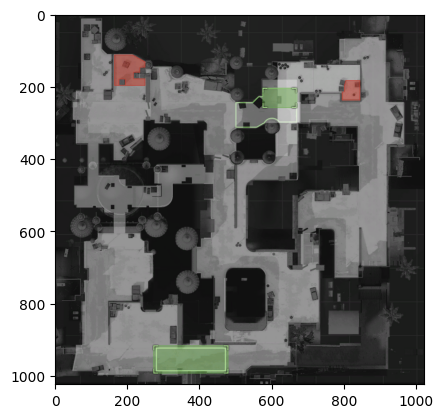

In [10]:
plt.imshow(bg)

#### We're gonna split some data to look at the first attacks in de_dust2

In [59]:
df_dedust2_pistol = df_dedust2.filter((pl.col("att_side").is_in(["Terrorist"])) & (pl.col("seconds") <= 120))
df_dedust2_larger = df_dedust2.filter((pl.col("att_side").is_in(["Terrorist"])) & (pl.col("seconds").is_between(120, 240, "right")))
df_dedust2_larger2 = df_dedust2.filter((pl.col("att_side").is_in(["Terrorist"])) & (pl.col("seconds").is_between(240, 360, "right")))

df_dedust2_pistolct = df_dedust2.filter((pl.col("vic_side").is_in(["CounterTerrorist"])) & (pl.col("seconds") <= 120))
df_dedust2_largerct = df_dedust2.filter((pl.col("vic_side").is_in(["CounterTerrorist"])) & (pl.col("seconds").is_between(120, 240, "right")))
df_dedust2_larger2ct = df_dedust2.filter((pl.col("vic_side").is_in(["CounterTerrorist"])) & (pl.col("seconds").is_between(240, 360, "right")))
map_dedust2 = map_data.filter(pl.col("map").is_in(["de_dust2"]))


def rescale_coords(input_data: pl.DataFrame) -> pl.DataFrame:
    input_data = input_data.with_columns([
        ((map_dedust2["ResX"] * (pl.col("att_pos_x") - map_dedust2["StartX"])) / (map_dedust2["EndX"] - map_dedust2["StartX"])).alias("scaled_att_pos_x"),
        ((map_dedust2["ResY"] * (pl.col("att_pos_y") - map_dedust2["StartY"])) / (map_dedust2["EndY"] - map_dedust2["StartY"])).alias("scaled_att_pos_y"),

        ((map_dedust2["ResX"] * (pl.col("vic_pos_x") - map_dedust2["StartX"])) / (map_dedust2["EndX"] - map_dedust2["StartX"])).alias("scaled_vic_pos_x"),
        ((map_dedust2["ResY"] * (pl.col("vic_pos_y") - map_dedust2["StartY"])) / (map_dedust2["EndY"] - map_dedust2["StartY"])).alias("scaled_vic_pos_y"),
    ])
    
    return input_data

list_of_dfs = [df_dedust2_pistol, df_dedust2_larger, df_dedust2_larger2, df_dedust2_pistol, df_dedust2_larger, df_dedust2_larger2]

df_dedust2_pistol, df_dedust2_larger, df_dedust2_larger2, df_dedust2_pistolct, df_dedust2_largerct, df_dedust2_larger2ct = [rescale_coords(polars_df) for polars_df in list_of_dfs]

(112, 7551, 6437, 112, 7551, 6437)

#### In the first 120 seconds, we see how Terrorists attack Counter-Terrorists in de_dust2

<Axes: title={'center': 'Terrorists (magma) first attack on CT (copper) within 120 seconds (2 minutes)'}, xlabel='scaled_att_pos_x', ylabel='scaled_att_pos_y'>

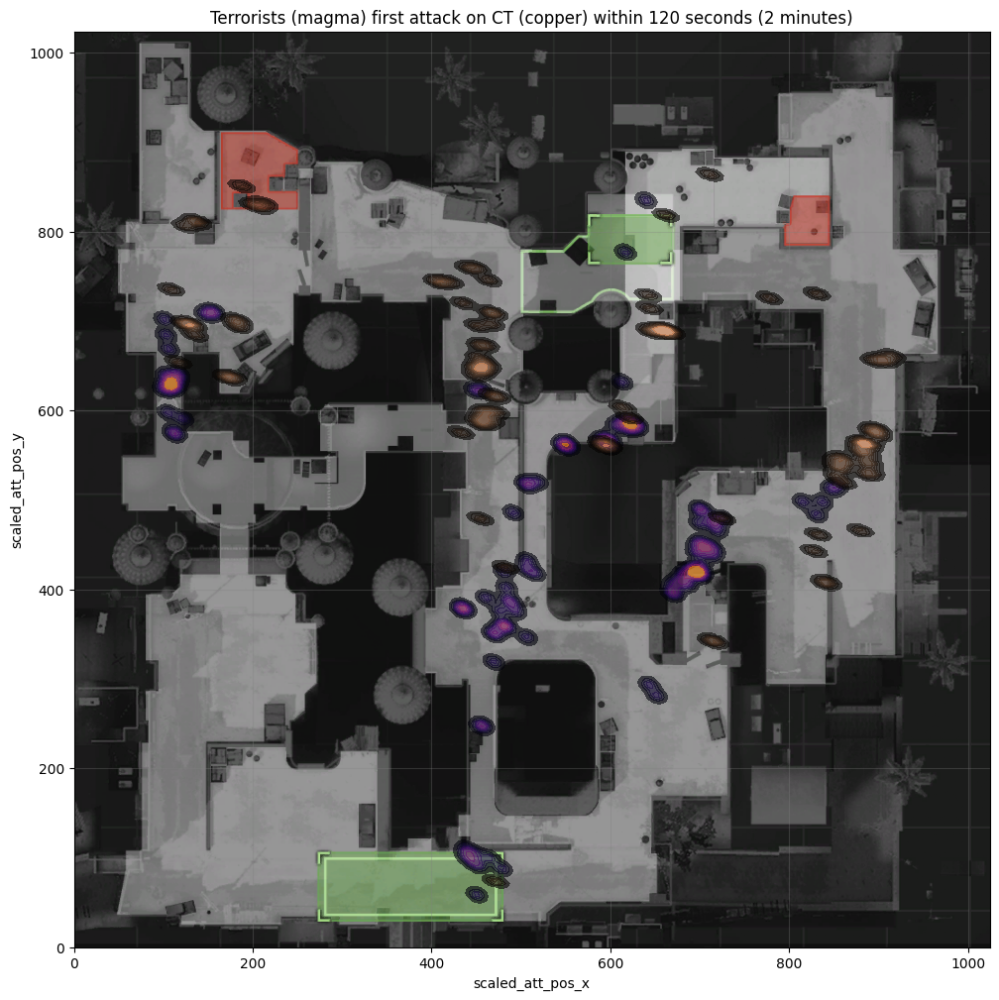

In [65]:
fig, (ax1) = plt.subplots(1,1, figsize=(25, 12))
ax1.grid(which='major', color='gray', alpha=.3)
ax1.imshow(bg ,extent=[0.0, 1024, 0.0, 1024], zorder=0)
ax1.set_ylim(0,1024)
ax1.set_xlim(0, 1024)


sns.kdeplot(x=df_dedust2_pistol["scaled_att_pos_x"], y=df_dedust2_pistol["scaled_att_pos_y"], ax=ax1, cmap="inferno", fill=True, bw_method=.03, alpha=.6, common_norm=True)
ax1.set_title("Terrorists (magma) first attack on CT (copper) within 120 seconds (2 minutes)")

sns.kdeplot(x=df_dedust2_pistolct["scaled_vic_pos_x"], y=df_dedust2_pistolct["scaled_vic_pos_y"], ax=ax1, cmap="copper", fill=True, bw_method=.03, alpha=.6, common_norm=True)

Text(0.5, 1.0, 'CT getting attacked between 121-240 seconds (2-4 minutes)')

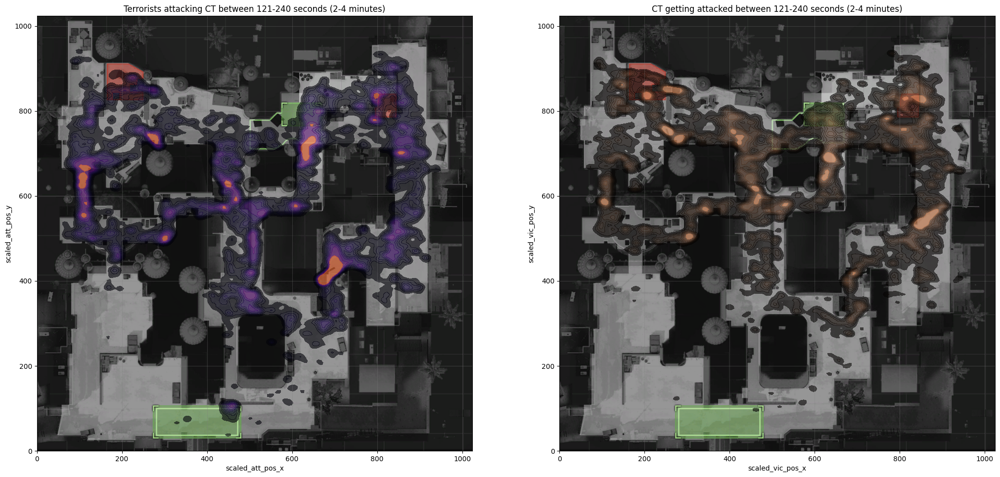

In [63]:
fig, (ax1, ax2) = plt.subplots(1,2, figsize=(25, 12))
ax1.grid(which='major', color='gray', alpha=.3)
ax1.imshow(bg ,extent=[0.0, 1024, 0.0, 1024], zorder=0)
ax1.set_ylim(0,1024)
ax1.set_xlim(0, 1024)
ax2.grid(which='major', color='gray', alpha=.3)
ax2.imshow(bg ,extent=[0.0, 1024, 0.0, 1024], zorder=0)



ax2.set_ylim(0,1024)
ax2.set_xlim(0, 1024)

sns.kdeplot(x=df_dedust2_larger["scaled_att_pos_x"], y=df_dedust2_larger["scaled_att_pos_y"], ax=ax1, cmap="inferno", fill=True, bw_method=.03, alpha=.6, common_norm=True)
ax1.set_title("Terrorists attacking CT between 121-240 seconds (2-4 minutes)")

sns.kdeplot(x=df_dedust2_largerct["scaled_vic_pos_x"], y=df_dedust2_largerct["scaled_vic_pos_y"], ax=ax2, cmap="copper", fill=True, bw_method=.03, alpha=.6, common_norm=True)
ax2.set_title("CT getting attacked between 121-240 seconds (2-4 minutes)")


#### Counter-Terrorists tend to buy more expensive equpiment than Terrorists regardless of who wins the match
We'll divide the Counter-Terrorists equipment value with the Terrorists equipment value after buy time to get the ratio <br>.
A ratio of 1 means that they are equivalent in value, <1 means that Terrorists have higher equpiment value and >1 means Counter-Terrorists have higher value

In [67]:
df_check = df.collect().with_columns([
    (pl.col("ct_eq_val")/pl.col("t_eq_val")).alias("ct_t_ratio_eq_val")
])

(0.0, 10.0)

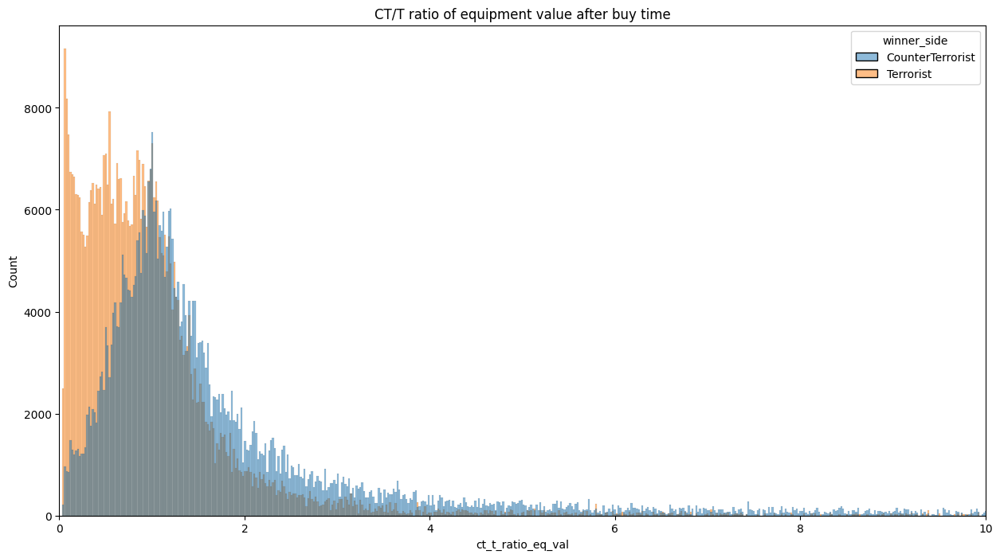

In [74]:
# df_dedust2_pistol = df_dedust2_pistol.with_columns([
#     pl.when(pl.col("att_side") == "Terrorist")
#     .then(pl.lit(1).alias("att_side_dummy"))
#     .otherwise(pl.lit(0).alias("att_side_dummy"))
# ])

# df_dedust2_pistol = df_dedust2_pistol.to_pandas()

plt.figure(figsize=(15,8))
sns.histplot(data=df_check.to_pandas(), x="ct_t_ratio_eq_val", hue="winner_side")
plt.title("CT/T ratio of equipment value after buy time")
plt.xlim(0, 10)

#### One weapon type is doing alot of `hp_dmg` but less `arm_dmg`
It is the 'Heavy' weapon type which consists of heavy weaponry like XM1014 and M249. <br>
But why is it showing 4 peaks around `arm_dmg`?

Text(0.5, 1.0, 'Damage done by different weapon types on healthpoint and arms')

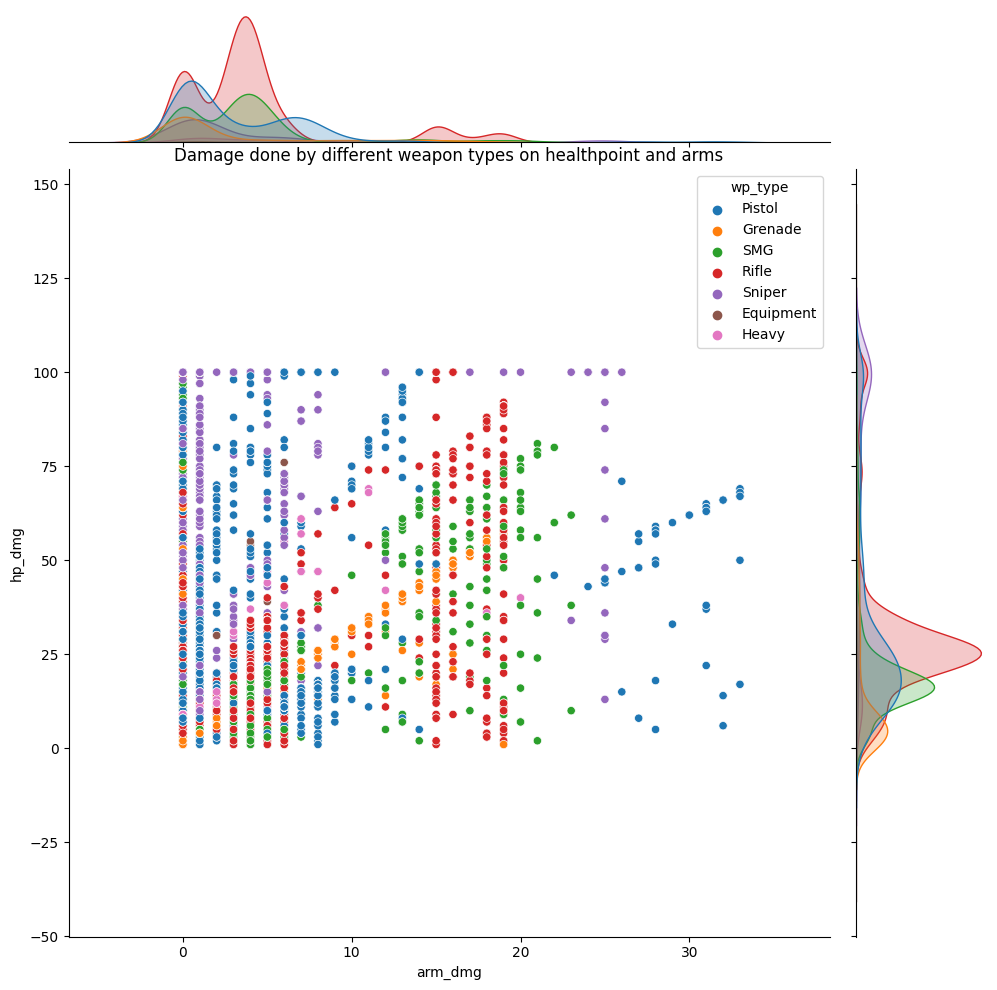

In [104]:

nsamples = 10000

check_wp_type = df_check.filter(pl.col("att_side").is_in(["CounterTerrorist", "Terrorist"]))[:nsamples]
sns.jointplot(x=check_wp_type["arm_dmg"], y=check_wp_type["hp_dmg"], hue=check_wp_type["wp_type"], height=10)

plt.title("Damage done by different weapon types on healthpoint and arms")

#### It seems to be the case that heavy weaponry takes a lot of healthpoints but does less arm damage as it is concentrated around four peaks
Let's look at the hitbox on this type of weapon. <br>

<Axes: xlabel='arm_dmg', ylabel='Density'>

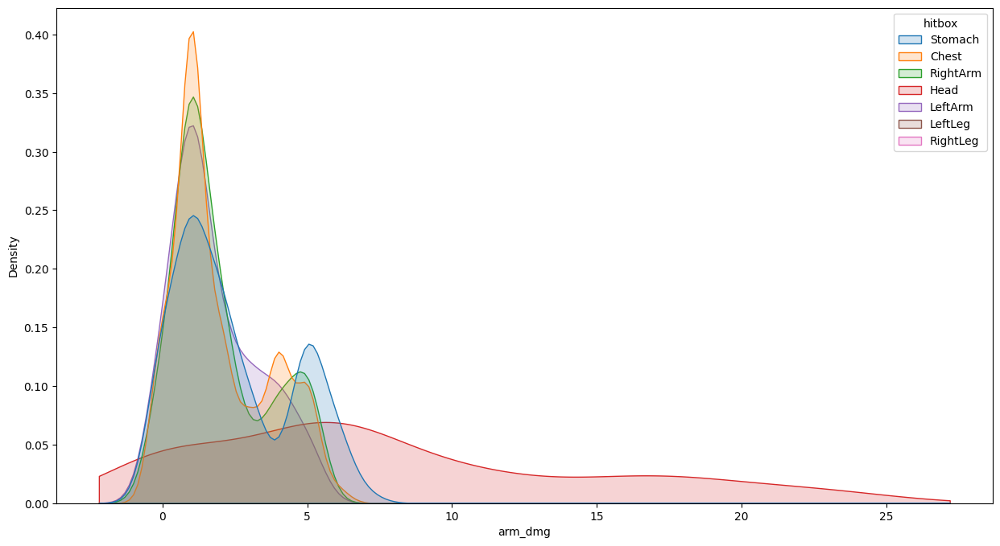

In [100]:
heavy = check_wp_type.filter(pl.col("wp_type") == "Heavy")

plt.figure(figsize=(15,8))
sns.kdeplot(x=heavy["arm_dmg"], hue=heavy["hitbox"], fill=True, alpha=.2, common_norm=False, common_grid=True)

Interesting is that when the heavy weapons hit the head, it also tend to have a very large spread on `arm_dmg`. <br>
This could either indicate that heavy weaponry gets a damage boost on armor when hitting the head or vice versa. <br>
Or, it can indicate that the Kevlar has been heavily damaged after hitting the head and thus shows high variability in `arm_dmg`.

#### Moving on to see some grouped summary statistics of the different maps
`de_train`, `de_mirage`, `de_dust2`, `de_cache`, `de_overpass`, and `de_cbble` have had the highest number of different weapons. <br>
`de_aztec` have had the lowest number of different weapons suggesting the map creates preferences among both sides. <br>
<br>

In [117]:
df_check.filter(pl.col("att_side").is_in(["CounterTerrorist", "Terrorist"])).group_by(["map", "att_side"]).agg(
    pl.col("att_team").n_unique(),
    pl.col("vic_team").n_unique(),
    pl.col("round_type").n_unique(),
    pl.col("hitbox").n_unique(),
    pl.col("wp").n_unique(),
    pl.col("wp_type").n_unique(),
    pl.col("file").n_unique()
).pivot(index="map", columns="att_side", values="wp").sort(["CounterTerrorist","Terrorist"], descending=True)

map,CounterTerrorist,Terrorist
str,u32,u32
"""de_dust2""",40,41
"""de_mirage""",39,41
"""de_cache""",39,40
"""de_cbble""",39,40
"""de_inferno""",39,39
"""de_train""",39,39
"""de_overpass""",38,40
"""cs_office""",36,34
"""de_nuke""",33,32


#### Which weapon is preferred on `de_aztec`?
Judging from below it seems that XM1014 is the most preferred weapon which is a shotgun. <br>

In [216]:
(df_check.filter((pl.col("att_side").is_in(["CounterTerrorist", "Terrorist"])) & (pl.col("map") == "de_aztec"))
 .group_by("att_side", "wp")
 .agg(pl.count("wp").suffix("_count"))
 ).pivot(index="wp", columns="att_side", values="wp_count").fill_null(0).sort(by=["Terrorist", "CounterTerrorist"],descending=True).max()

wp,CounterTerrorist,Terrorist
str,u32,u32
"""XM1014""",61,45


#### Now we'll look at the win ratio for each map

The win ratio for each map and each bomb site to plot will give us some information about the CS-GO competitive matchmaking games.<br>
One thing to remember is that the map and the bomb site are not indicators of the win ratio. <br>
They are merely for statistical analysis here.

In [472]:
df_pd = df.collect().to_pandas()

In [217]:
ctab = df_check.to_pandas()

In [218]:
win_percs = pd.crosstab(ctab["map"], [ctab["winner_side"], ctab["bomb_site"]], values=ctab["winner_side"], aggfunc="count", normalize="index").T.reset_index()
win_percs

map,winner_side,bomb_site,de_austria,de_aztec,de_blackgold,de_cache,de_canals,de_cbble,de_dust,de_dust2,de_inferno,de_mirage,de_nuke,de_overpass,de_shipped,de_thrill,de_train,de_vertigo
0,CounterTerrorist,A,0.000000,0.0,0.000000,0.134575,0.067708,0.106312,0.000000,0.124927,0.106680,0.132717,0.116421,0.102487,0.093750,0.146684,0.120166,0.022222
1,CounterTerrorist,B,0.130312,0.0,0.333333,0.118205,0.296875,0.104953,0.233645,0.112172,0.085909,0.123030,0.199288,0.170488,0.052083,0.094388,0.235551,0.185185
2,Terrorist,A,0.484419,0.2,0.309524,0.417028,0.312500,0.337964,0.383178,0.420758,0.397591,0.401387,0.391967,0.277346,0.531250,0.306122,0.376923,0.570370
3,Terrorist,B,0.385269,0.8,0.357143,0.330192,0.322917,0.450770,0.383178,0.342143,0.409820,0.342867,0.292323,0.449679,0.322917,0.452806,0.267360,0.222222


<b>It looks like Terrorists have a high win ratio when the map is *de_shipped* and *de_vertigo* if the bomb was planted at site A <br> and *de_cbble* if planted at site B but Counter-Terrorists
have their highest on *de_canals* but only if the bomb was planted at site B.</b>

<Axes: xlabel='map', ylabel='winner_side-bomb_site'>

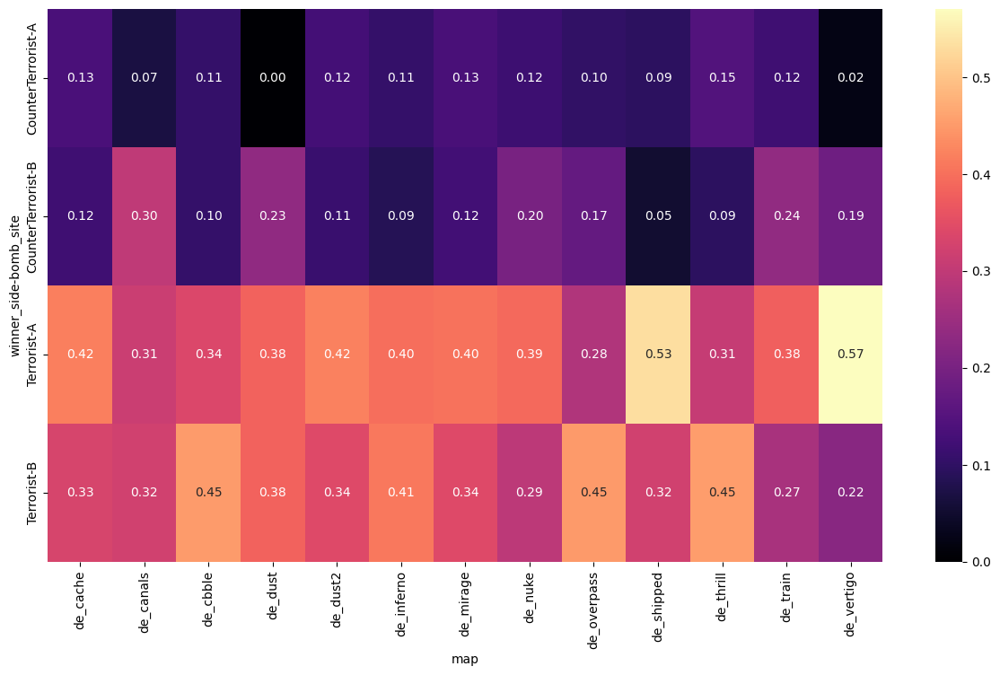

In [299]:
plt.figure(figsize=(15, 8))
sns.heatmap(win_percs.set_index(["winner_side", "bomb_site"]).iloc[:, 3:], annot=True, fmt=".2f", cmap="magma")

#### Let's inspect de_cbble
Will we find something interesting in the attacking patterns of Terrorists and Counter-Terrorists?<br>
We'll plot and find out.


In [219]:

df_vertigo = df.filter(pl.col("map").is_in(["de_cbble"])).collect()
map_dedust2 = map_data.filter(pl.col("map").is_in(["de_cbble"]))


df_vertigo = df_vertigo.with_columns([
    ((map_dedust2["ResX"] * (pl.col("att_pos_x") - map_dedust2["StartX"])) / (map_dedust2["EndX"] - map_dedust2["StartX"])).alias("scaled_att_pos_x"),
    ((map_dedust2["ResY"] * (pl.col("att_pos_y") - map_dedust2["StartY"])) / (map_dedust2["EndY"] - map_dedust2["StartY"])).alias("scaled_att_pos_y"),

    ((map_dedust2["ResX"] * (pl.col("vic_pos_x") - map_dedust2["StartX"])) / (map_dedust2["EndX"] - map_dedust2["StartX"])).alias("scaled_vic_pos_x"),
    ((map_dedust2["ResY"] * (pl.col("vic_pos_y") - map_dedust2["StartY"])) / (map_dedust2["EndY"] - map_dedust2["StartY"])).alias("scaled_vic_pos_y"),
    
])

df_vertigo_terr = df_vertigo.filter(pl.col("att_side").is_in(["Terrorist"]))
df_vertigo_ct = df_vertigo.filter(pl.col("att_side").is_in(["CounterTerrorist"]))

Text(0.5, 1.0, 'Counter-Terrorist attacking on de_cbble')

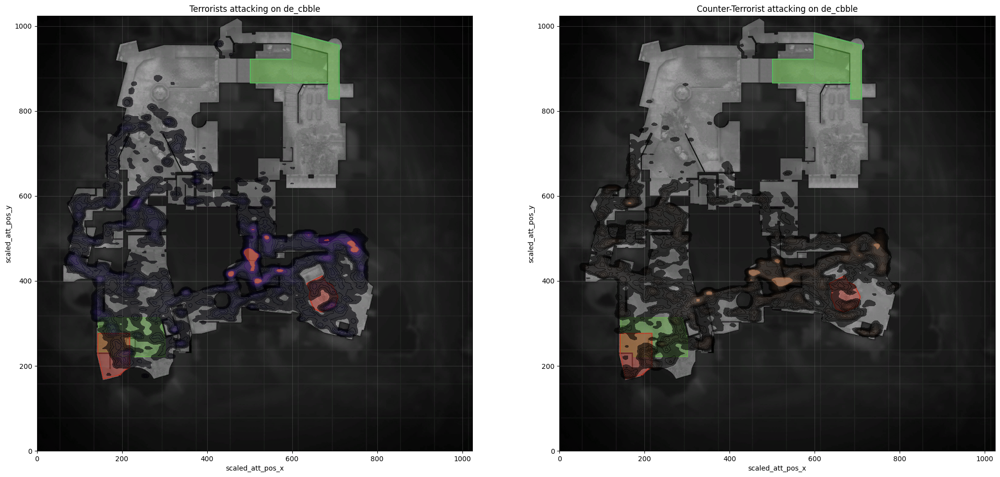

In [220]:

bg = imread('cs-go_competitive_mm/de_cbble.png')

fig, (ax1, ax2) = plt.subplots(1,2, figsize=(25, 12))
ax1.grid(which='major', color='gray', alpha=.3)
ax1.imshow(bg ,extent=[0.0, 1024, 0.0, 1024], zorder=0)
ax1.set_ylim(0,1024)
ax1.set_xlim(0, 1024)

ax2.grid(which='major', color='gray', alpha=.3)
ax2.imshow(bg ,extent=[0.0, 1024, 0.0, 1024], zorder=0)
ax2.set_ylim(0,1024)
ax2.set_xlim(0, 1024)


sns.kdeplot(x=df_vertigo_terr["scaled_att_pos_x"], y=df_vertigo_terr["scaled_att_pos_y"], ax=ax1, cmap="inferno", fill=True, bw_method=.03, alpha=.6, common_norm=True)
ax1.set_title("Terrorists attacking on de_cbble")

sns.kdeplot(x=df_vertigo_ct["scaled_att_pos_x"], y=df_vertigo_ct["scaled_att_pos_y"], ax=ax2, cmap="copper", fill=True, bw_method=.03, alpha=.6, common_norm=True)
ax2.set_title("Counter-Terrorist attacking on de_cbble")


#### Similar patterns found
Judging by the plot above we find that both sides concentrate near each other at the lower center of the map.<br>
But that involves all weapon types. How about looking at grenade only?

In [221]:
df_vertigo_terr_grenade = df_vertigo_terr.filter(pl.col("wp_type") == "Grenade")
df_vertigo_ct_grenade = df_vertigo_ct.filter(pl.col("wp_type") == "Grenade")

Text(0.5, 1.0, 'Counter-Terrorist attacking on de_cbble with Grenade')

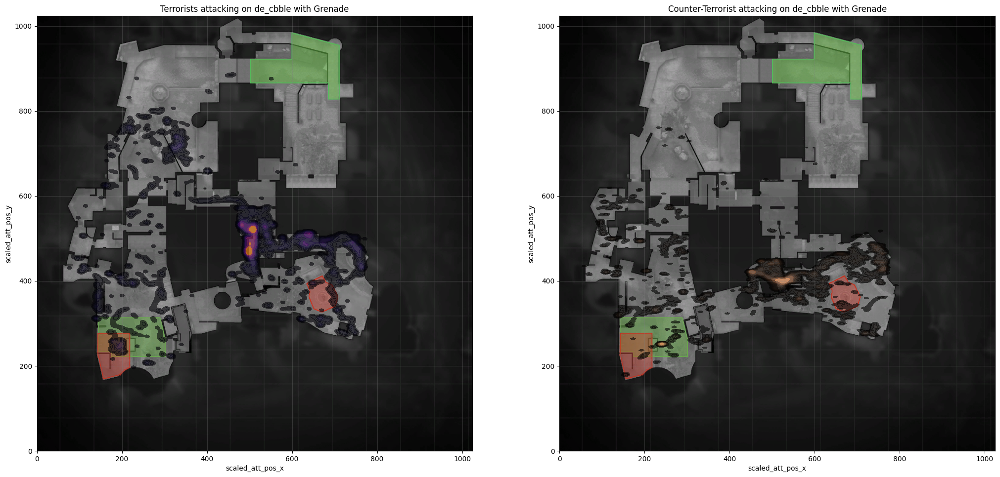

In [222]:
bg = imread('cs-go_competitive_mm/de_cbble.png')

fig, (ax1, ax2) = plt.subplots(1,2, figsize=(25, 12))
ax1.grid(which='major', color='gray', alpha=.3)
ax1.imshow(bg ,extent=[0.0, 1024, 0.0, 1024], zorder=0)
ax1.set_ylim(0,1024)
ax1.set_xlim(0, 1024)

ax2.grid(which='major', color='gray', alpha=.3)
ax2.imshow(bg ,extent=[0.0, 1024, 0.0, 1024], zorder=0)
ax2.set_ylim(0,1024)
ax2.set_xlim(0, 1024)


sns.kdeplot(x=df_vertigo_terr_grenade["scaled_att_pos_x"], y=df_vertigo_terr_grenade["scaled_att_pos_y"], ax=ax1, cmap="inferno", fill=True, bw_method=.03, alpha=.6, common_norm=True)
ax1.set_title("Terrorists attacking on de_cbble with Grenade")

sns.kdeplot(x=df_vertigo_ct_grenade["scaled_att_pos_x"], y=df_vertigo_ct_grenade["scaled_att_pos_y"], ax=ax2, cmap="copper", fill=True, bw_method=.03, alpha=.6, common_norm=True)
ax2.set_title("Counter-Terrorist attacking on de_cbble with Grenade")

### Terrorists have a larger attack variation with grenades than Counter-Terrorists where they cover more of the map

### Let's have a look at the first 4-5 minutes of Terrorist attacks by animating it


In [223]:
data = df_vertigo_terr.to_pandas()[["scaled_att_pos_x", "scaled_att_pos_y", "seconds"]]
data = data.sort_values(by="seconds").reset_index().drop(columns="index").to_numpy()
data.shape

(24145, 3)

In [224]:
from matplotlib.animation import FuncAnimation
# data = np.random.randn(1000, 2)  # 1000 points in 2 dimensions
# Setup the figure and axis for animation
fig, ax = plt.subplots(figsize=(25, 12))
plt.close()  # Prevents the static plot from displaying


def update(num, data, ax):
    ax.clear()  # Clear the axis to update the plot
    ax.grid(which='major', color='gray', alpha=.3)
    ax.imshow(bg ,extent=[0.0, 1024, 0.0, 1024], zorder=0)
    sns.kdeplot(x=data[:num, 0], y=data[:num, 1], ax=ax, fill=True, bw_method=0.03, alpha=.6, common_norm=True, cmap="magma")
    
    ax.set_xlim(0, 1024)
    ax.set_ylim(0, 1024)
    ax.set_title(f"{round(data[num, 2] / 60, 2)} minutes into the match with Terrorist attacks")

# Create animation
ani = FuncAnimation(fig, update, frames=np.linspace(0, 10000, 100).astype(int),
                    fargs=(data, ax), interval=100)

# Display the animation
from IPython.display import HTML
HTML(ani.to_jshtml())




Animation size has reached 20980730 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


#### Did you see the first 2-ish minutes?
Terrorists are spreading out their initial attacks as if they are unsynchronized. They then almost create a synchronized effort to create a high density region in the lower center of the map. <br>
How quick it clusters in that part of the map lends evidence to that these teams communicates in a voice channel or by sitting next to each other.

#### Moving on to infer some probabilistic information about the recorded attacks
If we filter on both sides, Counter-Terrorists and Terrorists, and divide them up into different round types, we should be able to differentiate between them. <br>
<br>
<b>SEMI_ECO</b>: *This type of economic strategy is typically executed when your team’s economy is uneven or you’re attempting to knock down a stronger team a bit. <br>Essentially the richer members on your team will spend approximately half of their money loading up while the poorer members will avoid spending anything if possible. <br>The aim of the strategy is to prepare for a full buy during the upcoming round while trying to force the opposing team to have to rebuy for a few players as well.* <br>
<br>
<b>FORCE_BUY & NORMAL</b>: *A full-buy, quite simply, is when a team buys all the needed armor, weapons, and utilities. <br> This is the ideal scenario for a team to be in and really opens up the possibility of successful attacks or defends.<br>
A force buy is used to try to stop the enemy team from gaining too much momentum. The forcing team will usually buy a mixture of smgs and/or rifles, with the rifles often using the last available funds instead of utility.<br> Stopping the enemy’s momentum can really stop a runaway lead by the enemy, however it’s a huge risk as it can set the forcing team back 1-2 rounds if it doesn’t work out.<br>*
<br>
<b>ECO & PISTOL_ROUND</b>: *In an eco round, you’ll either buy light equipment or purchase no equipment dependent on the amount of money you want to bring into the next rounds.<br> Essentially, eco rounds allow you as a player and team to save money to afford better weapons as well as equipment moving forward. <br>However, this can be countered by the enemy team performing an anti-eco round so keep your intentions to yourself.<br>
For an anti-eco round, you’ll purchase cheaper weapons such as SMG’s and avoid buying rifles or awps (essentially, you’re going to be a bit more frugal).<br> However, you should still purchase utility to prevent rushes and other desperate strategies that teams typically try on eco rounds.<br> This type of buy strategy is typically executed when you know the state of the economy of the enemy team and have eliminated the need to full buy.* <br>
<br>
Source: https://leetify.com/blog/understanding-csgo-economy/

Text(0.5, 1.0, 'ECDF: $P(X < x)$ where $X =$ Seconds into the match an attack was recorded - round_type: NORMAL')

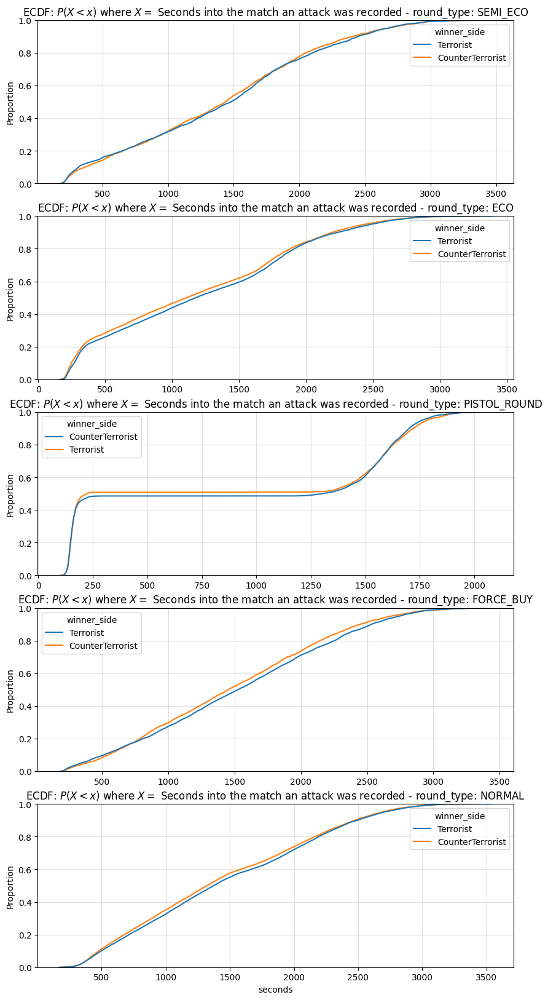

In [273]:
fig, (ax1, ax2, ax3, ax4, ax5) = plt.subplots(5, 1, figsize=(10, 20))
ax1.grid(True, alpha=.4)
ax2.grid(True, alpha=.4)
ax3.grid(True, alpha=.4)
ax4.grid(True, alpha=.4)
ax5.grid(True, alpha=.4)


sns.ecdfplot(df_check.filter((pl.col("att_side").is_in(["CounterTerrorist", "Terrorist"])) & (~pl.col("wp_type").is_in(["Unkown"])) & (pl.col("round_type") == "SEMI_ECO")), x="seconds", hue="winner_side", ax=ax1)
sns.ecdfplot(df_check.filter((pl.col("att_side").is_in(["CounterTerrorist", "Terrorist"])) & (~pl.col("wp_type").is_in(["Unkown"])) & (pl.col("round_type") == "ECO")), x="seconds", hue="winner_side", ax=ax2)
sns.ecdfplot(df_check.filter((pl.col("att_side").is_in(["CounterTerrorist", "Terrorist"])) & (~pl.col("wp_type").is_in(["Unkown"])) & (pl.col("round_type") == "PISTOL_ROUND")), x="seconds", hue="winner_side", ax=ax3)
sns.ecdfplot(df_check.filter((pl.col("att_side").is_in(["CounterTerrorist", "Terrorist"])) & (~pl.col("wp_type").is_in(["Unkown"])) & (pl.col("round_type") == "FORCE_BUY")), x="seconds", hue="winner_side", ax=ax4)
sns.ecdfplot(df_check.filter((pl.col("att_side").is_in(["CounterTerrorist", "Terrorist"])) & (~pl.col("wp_type").is_in(["Unkown"])) & (pl.col("round_type") == "NORMAL")), x="seconds", hue="winner_side", ax=ax5)
# plt.xlim(0, 800)
# plt.ylim(0, .44)
round_types = ['NORMAL', 'SEMI_ECO', 'FORCE_BUY', 'ECO', 'PISTOL_ROUND']
title_text = r"ECDF: $P(X < x)$ where $X =$ Seconds into the match an attack was recorded"

ax1.set_title(title_text + f" - round_type: {round_types[1]}")
ax1.set_xlabel("")
ax2.set_title(title_text + f" - round_type: {round_types[3]}")
ax2.set_xlabel("")
ax3.set_title(title_text + f" - round_type: {round_types[4]}")
ax3.set_xlabel("")
ax4.set_title(title_text + f" - round_type: {round_types[2]}")
ax4.set_xlabel("")
ax5.set_title(title_text + f" - round_type: {round_types[0]}")

#### What did you look at, you might ponder?
Well, see it this way. The higher the probability, or proportion, and the longer into the match we go, that indicates the aggressiveness or the pressure the winning team is putting. <br>
For instance, look at the last one with round type: <b>NORMAL</b>. The Counter-Terrorrists have a higher pressure by attacking more frequently in a shorter amount of time than when Terrorists win that round type. <br>
<br>
Or perhaps if you look at the <b>PISTOL_ROUND</b>, at about 200 seconds into the match both sides have the same aggressive pressure but then Terrorists outperform Counter-Terrorists. <br>
Something else is interesting with that round type. The pressure is constant after 200 seconds meaning the same amount of pressure is done, regardless of which side wins the round type, until about 1500 seconds in.

#### Let's look at whom has the first attack in *n* seconds into the match!

In [276]:


df_check_first_event = df_check.group_by("file").agg(
    pl.col("seconds").min().alias("first_event")
)

df_check_clean = df_check.join(df_check_first_event, on="file").with_columns([
    pl.when(
        pl.col("first_event") == pl.col("seconds")
    )
    .then(
        pl.col("att_side").alias("first_attacker")
    )
]).with_columns([

    pl.when(
        pl.col("file").shift(0) == pl.col("file").shift(1)
    )
    .then(
        pl.col("first_attacker").fill_null(strategy="forward")
    )
    .otherwise(pl.col("first_attacker"))
])




Text(0.5, 0, 'seconds into the match')

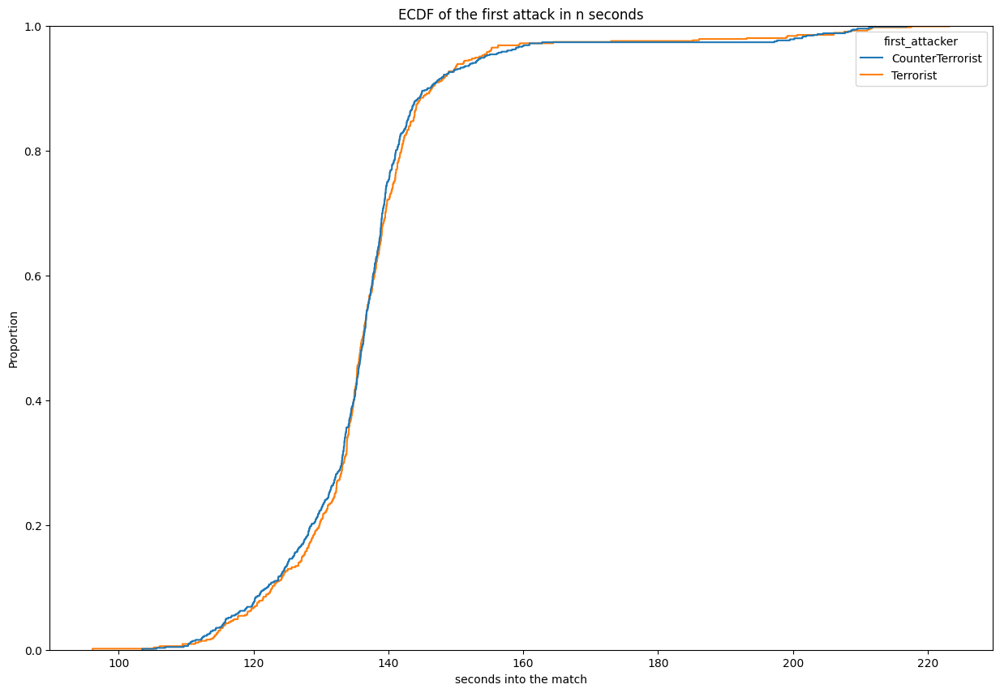

In [277]:
plt.figure(figsize=(15, 10))
sns.ecdfplot(df_check_clean.filter(pl.col("first_attacker").is_in(["CounterTerrorist", "Terrorist"])), x="first_event", hue="first_attacker")
plt.title("ECDF of the first attack in n seconds")
plt.xlabel("seconds into the match")

#### Looks quite similar on both sides with a bit of variability over time. However, Counter-Terrorists have a higher propensity to be quick to attack the first 2 minutes into the match.

#### We can build a function to mathematically evaluate the probabilities of each attacker by only having seconds as input
<b>You could ask the question: what is the probability that Terrorists attack in the first 2 minutes of a match? </b>

In [279]:
from scipy import stats

# Build the cdf evaluator
def probs_t_vs_ct(first_event_in_seconds=120, suppress=False) -> str:

    vals = df_check_clean.filter(pl.col("first_attacker").is_in(["Terrorist"]))["first_event"].to_list()
    vals_ct = df_check_clean.filter(pl.col("first_attacker").is_in(["CounterTerrorist"]))["first_event"].to_list()

    first_event_ecdf = stats.ecdf(vals)
    first_event_ecdf_ct = stats.ecdf(vals_ct)

    n_dec = 4
    
    t_val = round( float(first_event_ecdf.cdf.evaluate(first_event_in_seconds)) , n_dec) * 100
    ct_val = round( float(first_event_ecdf_ct.cdf.evaluate(first_event_in_seconds)) , n_dec) * 100

    if not suppress:
        print(f"The probability that CT have the first attack in the first {first_event_in_seconds} seconds in a match is {ct_val}%")
        print(f"The probability that Terrorists have the first attack in the first {first_event_in_seconds} seconds in a match is {t_val}%")
    
    return t_val, ct_val


Now that we've created our function we can give it some values and see its output

In [281]:
sample_seconds = [100, 120, 150, 170, 190, 210]

for sec in sample_seconds:
    probs_t_vs_ct(sec)
    print("---"*30)


The probability that CT have the first attack in the first 100 seconds in a match is 0.0%
The probability that Terrorists have the first attack in the first 100 seconds in a match is 0.18%
------------------------------------------------------------------------------------------
The probability that CT have the first attack in the first 120 seconds in a match is 7.57%
The probability that Terrorists have the first attack in the first 120 seconds in a match is 6.800000000000001%
------------------------------------------------------------------------------------------
The probability that CT have the first attack in the first 150 seconds in a match is 92.99%
The probability that Terrorists have the first attack in the first 150 seconds in a match is 93.28%
------------------------------------------------------------------------------------------
The probability that CT have the first attack in the first 170 seconds in a match is 97.35000000000001%
The probability that Terrorists have th

#### How about inspecting the first 20 minutes more closely?

Text(100, 0.07, 'Probability of first attack by T the first 120 seconds is 6.8%')

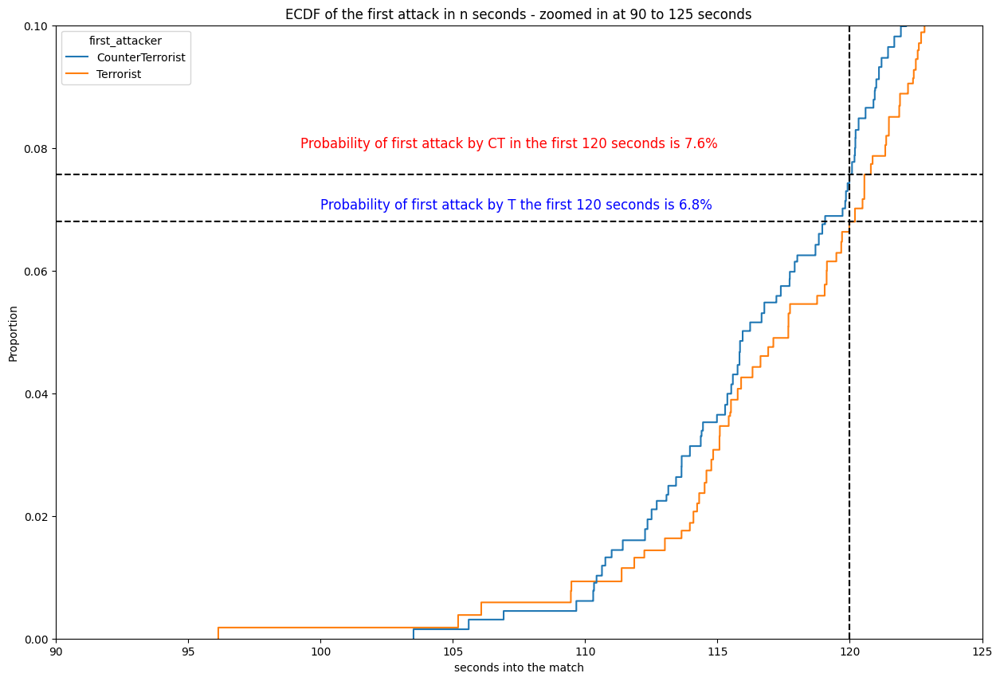

In [290]:
plt.figure(figsize=(15, 10))
sns.ecdfplot(df_check_clean.filter(pl.col("first_attacker").is_in(["CounterTerrorist", "Terrorist"])), x="first_event", hue="first_attacker")

# Lists of positions for vertical and horizontal lines
verti = [120, 120, 190, 190]
horiz = [0.0757, 0.068, 0.9735, 0.9787]


for v in verti:
    plt.axvline(x=v, color='black', linestyle='--') # Change the color if not zooming in


for h in horiz:
    plt.axhline(y=h, color="black", linestyle='--')

prob_t, prob_ct = probs_t_vs_ct(verti[0], suppress=True)
prob_t, prob_ct = round(prob_t, 1), round(prob_ct, 1)

plt.ylim(0, 0.1)
plt.xlim(90, 125)

coords = [115, 0.08]
text = f"Probability of first attack by CT in the first {verti[0]} seconds is {prob_ct}%"

coords2 = [100, 0.07]
text2 = f"Probability of first attack by T the first {verti[0]} seconds is {prob_t}%"

plt.title("ECDF of the first attack in n seconds - zoomed in at 90 to 125 seconds")
plt.xlabel("seconds into the match")
plt.text(coords[0], coords[1], text, fontsize=12, color='red', ha='right')
plt.text(coords2[0], coords2[1], text2, fontsize=12, color='blue', ha='left')


#### Another thing we can dive into is the time between the attacks for each attacker
This could tell us more about how each attacker behaves during attacks. If they hold the shoot button and just burst their ammo through or if they carefully attack.

In [332]:
def udf_time_attacks(group):
    group = group.with_columns([
    (abs(pl.col("seconds").shift(1) - pl.col("seconds").shift(0))).alias("time_between_attacks")
    ])
    
    return group

df_check_clean = df_check_clean.filter((pl.col("att_side").is_in(["CounterTerrorist", "Terrorist"])) & (pl.col("first_attacker").is_in(["CounterTerrorist", "Terrorist"]))).group_by(["file","att_id"]).map_groups(udf_time_attacks).fill_null(0)

#### In the density plot below there seems to be no evidence of any differences between Counter-Terrorists and Terrorists

(0.0, 35.0)

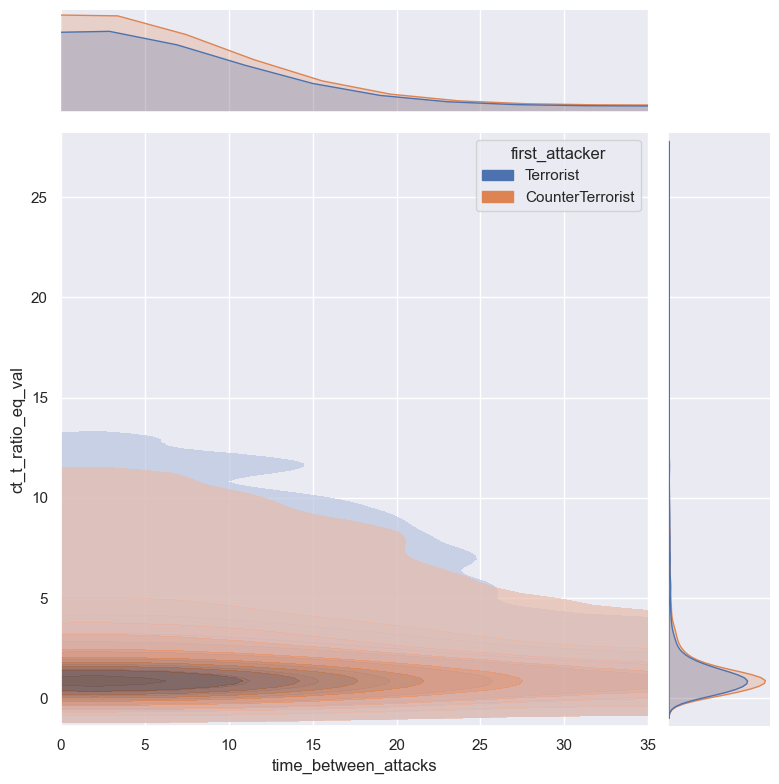

In [378]:
# optional: sns.set(style='darkgrid')
sns.jointplot(data=df_check_clean[:40000], 
x="time_between_attacks", 
y="ct_t_ratio_eq_val", 
hue="first_attacker", 
kind="kde", 
fill=True, 
joint_kws={"alpha": 0.7}, height=8)
plt.xlim(0, 35)

#### How about approaching it with a statistical approach? We'll test if there are actual differences between the attackers.

We will take the mean value of `time_between_attacks` for both Counter-Terrorists and Terrorists. <br>
Our hypothesis is that Terrorists differ from Counter-Terrorists. That means the factual hypothesis we want to disprove is that there is no difference.<br>

Our approach is a non-parametric test where we will use the rank sum of the `time_between_attacks` since it follows a truncated/censored distribution. <br>
We want to have a small effect size to detect small differences in large groups of Counter-Terrorists and Terrorists. This gives us a <b>scientific precision</b>. <br>

We want to have a two-sided test which gives us no preferred direction (larger than or less than is not important) and thus tests both ways. <br>
The significance level will be set to 1% (0.5% per direction) which translates into that for us to observe something atleast that extreme by random chance (but not due to it alone) is 1%. <br>

A common, but arbitrary set level, is to have p<0.05 which has no statistical validity at all therefore we will choose a much harder threshold by using p<0.01.

In [415]:
p_1 = 0.51
z_val_alpha = 2.576
z_val_beta = 0.84

def minimum_sample_size(z_alpha, z_beta, p_1):
    return round((z_val_alpha + z_val_beta)**2 / (6*(p_1 - 0.5)**2))

Text(0.1, 5, 'Region to lie within to reject the hypothesis that there is no difference between CT and T')

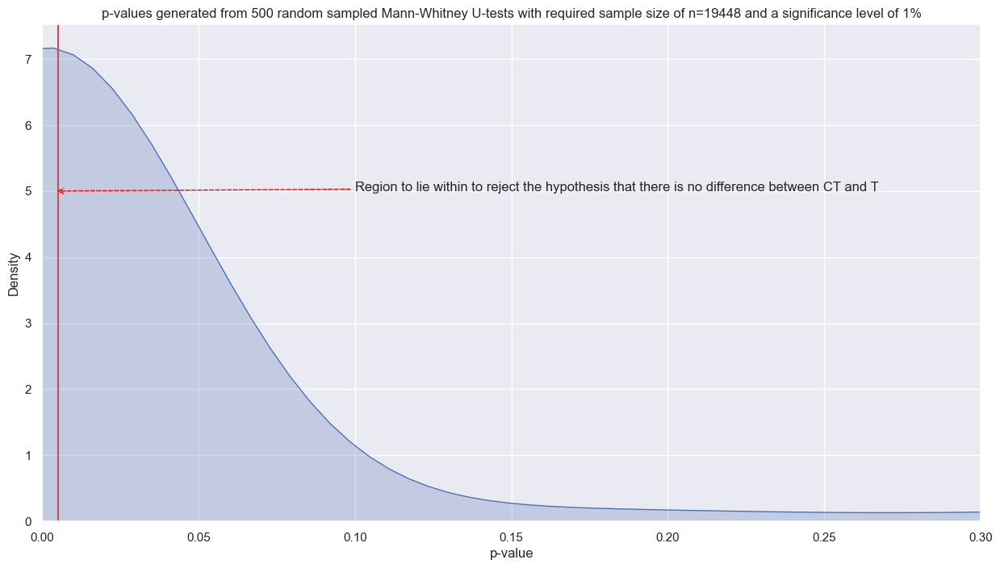

In [471]:
n_samples_to_test = minimum_sample_size(z_val_alpha, z_val_beta, p_1)
time_attacks_t = df_check_clean.filter(pl.col("first_attacker") == "Terrorist")["time_between_attacks"].to_numpy()
time_attacks_ct = df_check_clean.filter(pl.col("first_attacker") == "CounterTerrorist")["time_between_attacks"].to_numpy()

p_vals = []

for k in range(0, 500):
    time_attacks_t, time_attacks_ct = np.random.choice(time_attacks_t, size=n_samples_to_test), np.random.choice(time_attacks_ct, size=n_samples_to_test)
    stat, p_val = mannwhitneyu(time_attacks_ct, time_attacks_t)
    p_vals.append( round(p_val, 5) )

plt.figure(figsize=(15,8))
plt.title(f"p-values generated from 500 random sampled Mann-Whitney U-tests with required sample size of n={n_samples_to_test} and a significance level of 1%")
sns.kdeplot(p_vals, fill=True)
plt.xlim(0, 0.3)
plt.axvline(0.005, color="r")
plt.xlabel("p-value")

plt.annotate("Region to lie within to reject the hypothesis that there is no difference between CT and T", xy=(0.004, 5), xytext=(0.1, 5), arrowprops=dict(arrowstyle='->', color="red", ls="--"))

#### Why did we just generate 500 p-values from 500 different samples?
That is because we need to make sure that we didn't stop and celebrated a detectable result, when in fact over many samples there is no real difference. <br>
As seen in the above plot, when we randomly sample and test and iterate that procedure 500 times with different samples, we have no compelling evidence for a difference. <br>
<br>
This is to simulate a real-world experiment where we, for instance, have 10 000 players each and test their differences. Then take another 10 000 players each and test and so on.<br>
In the "end" we should get a good distribution of whether our findings are compatible with the data or not.

<b>In our case above, we do not have enough compelling evidence to reject the hypothesis that there is no difference between Counter-Terrorists and Terrorists. <br>
Meaning that we lack enough evidence to say that there is a difference between them!</b>